# Data Assessment & Analytics
Notes:
- change os directory location
- be aware of the number of provdied native source data files

In [1]:
# working with data
import os
import numpy as np
import pandas as pd
import geopandas as gpd # the library that lets us read in shapefiles
import geoplot as gplt # for plotting maps
import geoplot.crs as gcrs #used to pull in webdata

# visulizaiton
import missingno as msno # creates a matrix chart to show missing values
import plotly.express as px
import plotly.graph_objects as go # for subplot creation
from plotly.subplots import make_subplots # for subplot creation
import matplotlib.pyplot as mplt # use with gplt to save fig to pdf

# Cleanup
from datetime import datetime
pd.set_option('display.max_columns', 999)  # How to display all columns of a Pandas DataFrame in Jupyter Notebook

In [2]:
# Set Working Directory
workingDir = "G:/Shared drives/WaDE Data/Oregon/WaterAllocation" # change here
os.chdir(workingDir)

In [3]:
# This needs to be custom per state

# Input Data
#################################################################
# Data 1: ORwr_v_pod_public_input
df1 = pd.read_csv('RawinputData/wr_v_pod_public.zip')

# Data 2: WaterRightPOUs_input
df2 = pd.read_csv('RawinputData/wr_v_pou_public.zip')

C:\Users\rjame\AppData\Local\Temp\ipykernel_2376\2970899039.py:6: DtypeWarning: Columns (2,12,21) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv('RawinputData/wr_v_pod_public.zip')
C:\Users\rjame\AppData\Local\Temp\ipykernel_2376\2970899039.py:9: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  df2 = pd.read_csv('RawinputData/wr_v_pou_public.zip')


In [4]:
# Input Data - Processed WaDE Input files
#################################################################
dfws = pd.read_csv("ProcessedInputData/watersources.csv").replace(np.nan, "")
dfwspurge = pd.read_csv("ProcessedInputData/watersources_missing.csv").replace(np.nan, "")

dfs = pd.read_csv("ProcessedInputData/sites.csv").replace(np.nan, "")
dfspurge = pd.read_csv("ProcessedInputData/sites_missing.csv").replace(np.nan, "")

dfaa = pd.read_csv("ProcessedInputData/waterallocations.csv").replace(np.nan, "")
dfaapurge = pd.read_csv("ProcessedInputData/waterallocations_missing.csv").replace(np.nan, "")

C:\Users\rjame\AppData\Local\Temp\ipykernel_2376\367920039.py:6: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  dfs = pd.read_csv("ProcessedInputData/sites.csv").replace(np.nan, "")
C:\Users\rjame\AppData\Local\Temp\ipykernel_2376\367920039.py:7: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  dfspurge = pd.read_csv("ProcessedInputData/sites_missing.csv").replace(np.nan, "")
C:\Users\rjame\AppData\Local\Temp\ipykernel_2376\367920039.py:10: DtypeWarning: Columns (12,14,23) have mixed types. Specify dtype option on import or set low_memory=False.
  dfaapurge = pd.read_csv("ProcessedInputData/waterallocations_missing.csv").replace(np.nan, "")


## Removed Records

In [5]:
print("Records Removed from water source Info")
if len(dfwspurge) != 0:
    for x in dfwspurge['ReasonRemoved'].sort_values().unique():
        print(f'"' + str(x) + '",')
else:
    print("...nothing removed.")

Records Removed from water source Info
"Unused WaterSource Record",


In [6]:
print("Records Removed from site Info")
if len(dfspurge) != 0:
    for x in dfspurge['ReasonRemoved'].sort_values().unique():
        print(f'"' + str(x) + '",')
else:
    print("...nothing removed.")

Records Removed from site Info
"Unused Site Record",


In [7]:
print("Records Removed from Allocation Amount Info")
if len(dfaapurge) != 0:
    for x in dfaapurge['ReasonRemoved'].sort_values().unique():
        print(f'"' + str(x) + '",')
else:
    print("...nothing removed.")

Records Removed from Allocation Amount Info
"Incomplete or bad entry for AllocationCropDutyAmount",
"Incomplete or bad entry for AllocationPriorityDate",
"Incomplete or bad entry for AllocationTimeframeEnd",
"Incomplete or bad entry for AllocationTimeframeStart",
"Incomplete or bad entry for Flow",
"Incomplete or bad entry for IrrigatedAcreage",
"Incomplete or bad entry for Volume",


# Water Source Info
- watersources.csv

In [8]:
print(len(dfws))
dfws.head(1)

11887


,WaterSourceUUID,Geometry,GNISFeatureNameCV,WaterQualityIndicatorCV,WaterSourceName,WaterSourceNativeID,WaterSourceTypeCV
0,ORwr_WSwadeID1,,,Fresh,Reynolds Creek,wadeID1,Surface Water


<AxesSubplot: >

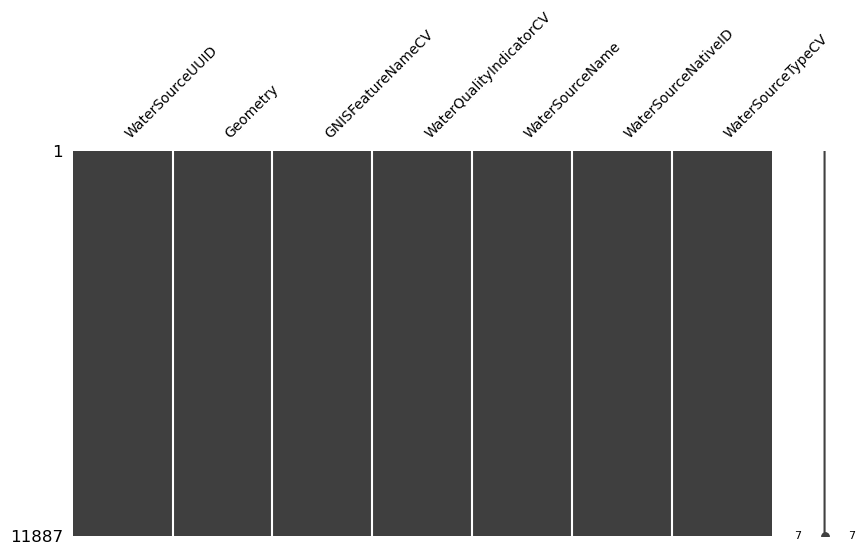

In [9]:
# Check what columns contain missing information.
msno.matrix(dfws, figsize=(10,5), fontsize=10)

In [10]:
# Unique values for 'WaterSourceTypeCV'
for x in dfws['WaterSourceTypeCV'].sort_values().unique():
    print(f'"' + x + '",')

"Groundwater",
"Storage",
"Surface Water",


In [11]:
# WaterSourceTypeCV: histogram distribution of WaDE values
print(dfws.WaterSourceTypeCV.value_counts())

fig = px.histogram(dfws, x="WaterSourceTypeCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of WaterSourceTypeCV Entries in watersource.csv",
                  xaxis_title="WaterSourceTypeCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/WaterSourceTypeCV.pdf', engine="kaleido")

Surface Water    6547
Storage          4342
Groundwater       998
Name: WaterSourceTypeCV, dtype: int64


# Site Info
- sites.csv

In [12]:
print(len(dfs))
dfs.head(1)

191479


,SiteUUID,RegulatoryOverlayUUIDs,WaterSourceUUIDs,CoordinateAccuracy,CoordinateMethodCV,County,EPSGCodeCV,Geometry,GNISCodeCV,HUC12,HUC8,Latitude,Longitude,NHDNetworkStatusCV,NHDProductCV,PODorPOUSite,SiteName,SiteNativeID,SitePoint,SiteTypeCV,StateCV,USGSSiteID
0,ORwr_SPOD10000,,ORwr_WSwadeID107,WaDE Blank,WaDE Blank,WaDE Blank,4326,,,,,45.207152,-123.058411,,,POD,WaDE Blank,POD10000,,well,OR,


<AxesSubplot: >

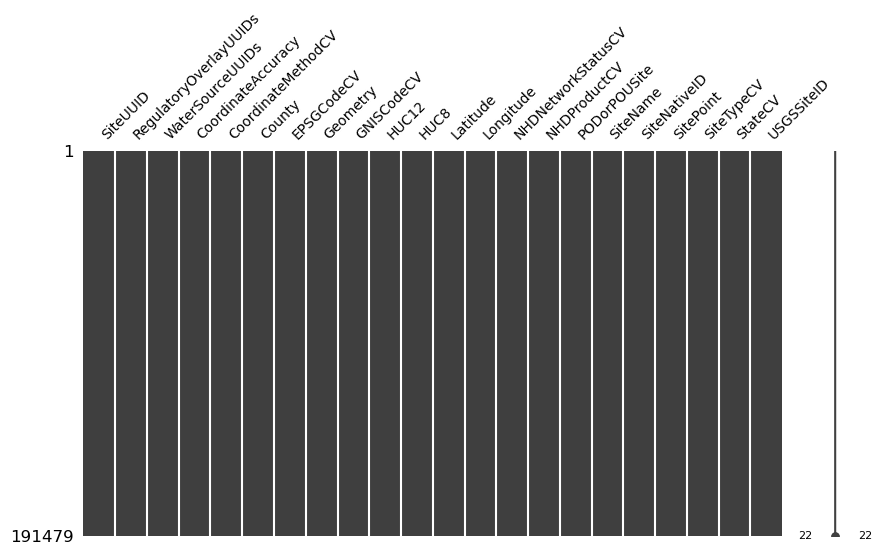

In [13]:
# Check what columns contain missing information.
msno.matrix(dfs, figsize=(10,5), fontsize=10)

In [14]:
# Unique values for 'CoordinateMethodCV'
for x in dfs['CoordinateMethodCV'].sort_values().unique():
    print(f'"' + x + '",')

"WaDE Blank",


In [15]:
# Unique values for 'SiteTypeCV'
for x in dfs['SiteTypeCV'].sort_values().unique():
    print(f'"' + x + '",')

"WaDE Blank",
"canal",
"ditch",
"drain",
"lake",
"pond",
"reservoir",
"sewage effluent",
"spring",
"stream",
"sump",
"waste water",
"well",
"winter runoff",


In [16]:
# SiteTypeCV: histogram distribution of WaDE values
print(dfs.SiteTypeCV.value_counts())

fig = px.histogram(dfs, x="SiteTypeCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of SiteTypeCV Entries in sites.csv",
                  xaxis_title="SiteTypeCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/SiteTypeCV.pdf', engine="kaleido")

WaDE Blank         109893
stream              47327
well                18101
spring               8979
reservoir            3493
winter runoff        1446
lake                 1198
sump                  473
waste water           429
drain                  67
ditch                  25
sewage effluent        22
pond                   19
canal                   7
Name: SiteTypeCV, dtype: int64


In [17]:
# PODorPOUSite: histogram distribution of WaDE values
print(dfs.PODorPOUSite.value_counts())

fig = px.histogram(dfs, x="PODorPOUSite")
fig.update_layout(bargap=0.2,
                  title="Histogram of PODorPOUSite Entries in sites.csv",
                  xaxis_title="PODorPOUSite Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/PODorPOUSite.pdf', engine="kaleido")

POU    109893
POD     81586
Name: PODorPOUSite, dtype: int64


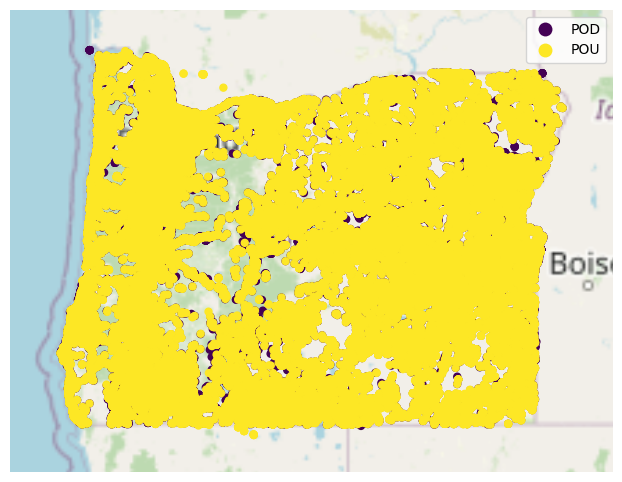

In [18]:
# map the site info (this would be lat & long Points only)
try:
    contiguous_usa = gpd.read_file(gplt.datasets.get_path('contiguous_usa')) # use for background map in subplot
    ax = gplt.webmap(contiguous_usa, projection=gcrs.WebMercator()) # set subplot
    
    dfsPoint = dfs.copy()
    gdfsPoint = gpd.GeoDataFrame(dfsPoint, geometry=gpd.points_from_xy(dfsPoint.Longitude.astype(float), dfsPoint.Latitude.astype(float)), crs="EPSG:4326")
    gplt.pointplot(gdfsPoint, hue='PODorPOUSite', legend=True, legend_var='hue', ax=ax)
    mplt.savefig(format="pdf", fname='DataAssessment/figures/PointMap.pdf')
    
except:
    print('No point data to plot')

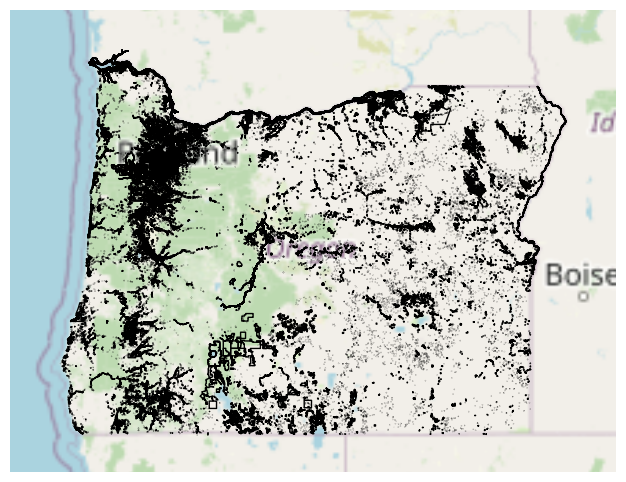

In [19]:
# Map poly info
try:
    contiguous_usa = gpd.read_file(gplt.datasets.get_path('contiguous_usa')) # use for background map in subplot
    ax = gplt.webmap(contiguous_usa, projection=gcrs.WebMercator()) # set subplot
    
    dfsPoly = dfs.copy()
    dfsPoly = dfsPoly[dfsPoly['Geometry'] != ""].reset_index(drop=True)
    dfsPoly['Geometry'] = gpd.GeoSeries.from_wkt(dfsPoly['Geometry'], crs="EPSG:4326")
    gdfsPoly = gpd.GeoDataFrame(dfsPoly, geometry=dfsPoly['Geometry'], crs="EPSG:4326") # covert to geodataframe
    gdfsPoly['Geometry'] = gdfsPoly.simplify(0.001) # simplify the geometry. Lower the number the larger the exported file.
    gplt.polyplot(gdfsPoly, ax=ax)
    mplt.savefig(format="pdf", fname='DataAssessment/figures/PolyMap.pdf')
except:
    print('No geometry data to plot')

In [20]:
dfsPoly.head()

,SiteUUID,RegulatoryOverlayUUIDs,WaterSourceUUIDs,CoordinateAccuracy,CoordinateMethodCV,County,EPSGCodeCV,Geometry,GNISCodeCV,HUC12,HUC8,Latitude,Longitude,NHDNetworkStatusCV,NHDProductCV,PODorPOUSite,SiteName,SiteNativeID,SitePoint,SiteTypeCV,StateCV,USGSSiteID,geometry
0,ORwr_SPOU100000,,ORwr_WSwadeID1270,WaDE Blank,WaDE Blank,WaDE Blank,4326,"POLYGON ((-123.38887 42.96515, -123.38898 42.9...",,,,42.965149,-123.388986,,,POU,WaDE Blank,POU100000,,WaDE Blank,OR,,"POLYGON ((-123.38887 42.96515, -123.38898 42.9..."
1,ORwr_SPOU100003,,ORwr_WSwadeID85,WaDE Blank,WaDE Blank,WaDE Blank,4326,"POLYGON ((-123.92431 44.59318, -123.92443 44.5...",,,,44.593259,-123.924313,,,POU,WaDE Blank,POU100003,,WaDE Blank,OR,,"POLYGON ((-123.92431 44.59318, -123.92443 44.5..."
2,ORwr_SPOU100004,,ORwr_WSwadeID3151,WaDE Blank,WaDE Blank,WaDE Blank,4326,"MULTIPOLYGON (((-123.34192 44.81562, -123.3438...",,,,44.817050,-123.341749,,,POU,WaDE Blank,POU100004,,WaDE Blank,OR,,"MULTIPOLYGON (((-123.34192 44.81562, -123.3438..."
3,ORwr_SPOU100005,,ORwr_WSwadeID46,WaDE Blank,WaDE Blank,WaDE Blank,4326,"MULTIPOLYGON (((-122.87731 43.96327, -122.8753...",,,,43.962174,-122.877764,,,POU,WaDE Blank,POU100005,,WaDE Blank,OR,,"MULTIPOLYGON (((-122.87731 43.96327, -122.8771..."
4,ORwr_SPOU100006,,ORwr_WSwadeID91,WaDE Blank,WaDE Blank,WaDE Blank,4326,"MULTIPOLYGON (((-116.79383 45.47343, -116.7952...",,,,45.474820,-116.795214,,,POU,WaDE Blank,POU100006,,WaDE Blank,OR,,"MULTIPOLYGON (((-116.79383 45.47343, -116.7942..."


# Allocation Amount Info
- waterallocations.csv

In [21]:
print(len(dfaa))
dfaa.head(1)

67761


,AllocationUUID,MethodUUID,OrganizationUUID,SiteUUID,VariableSpecificUUID,AllocationApplicationDate,AllocationAssociatedConsumptiveUseSiteIDs,AllocationAssociatedWithdrawalSiteIDs,AllocationBasisCV,AllocationChangeApplicationIndicator,AllocationCommunityWaterSupplySystem,AllocationCropDutyAmount,AllocationExpirationDate,AllocationFlow_CFS,AllocationLegalStatusCV,AllocationNativeID,AllocationOwner,AllocationPriorityDate,AllocationSDWISIdentifierCV,AllocationTimeframeEnd,AllocationTimeframeStart,AllocationTypeCV,AllocationVolume_AF,BeneficialUseCategory,CommunityWaterSupplySystem,CropTypeCV,CustomerTypeCV,DataPublicationDate,DataPublicationDOI,ExemptOfVolumeFlowPriority,GeneratedPowerCapacityMW,IrrigatedAcreage,IrrigationMethodCV,LegacyAllocationIDs,OwnerClassificationCV,PopulationServed,PowerType,PrimaryBeneficialUseCategory,WaterAllocationNativeURL
0,ORwr_WR100001,ORwr_M1,ORwr_O1,"ORwr_SPOU86682,ORwr_SPOD106791",ORwr_V1,,,,WaDE Blank,,,,,0.01,WaDE Blank,100001,Ted Nixon,1976-06-03,,12/31,1/1,WaDE Blank,0.0,DOMESTIC INCLUDING LAWN AND GARDEN,,,,06/08/2023,,0,,0.0,,,WaDE Blank,,,Domestic,https://apps.wrd.state.or.us/apps/wr/wrinfo/wr...


In [22]:
# Unique values for 'AllocationBasisCV'
for x in dfaa['AllocationBasisCV'].sort_values().unique():
    print(f'"' + str(x) + '",')

"WaDE Blank",


In [23]:
# Unique values for 'AllocationTypeCV'
for x in dfaa['AllocationTypeCV'].sort_values().unique():
    print(f'"' + x + '",')

"WaDE Blank",


In [24]:
# Unique values for 'AllocationLegalStatusCV'
for x in dfaa['AllocationLegalStatusCV'].sort_values().unique():
    print(f'"' + x + '",')

"WaDE Blank",


In [25]:
# Unique values for 'BeneficialUseCategory'
uniqueList = list(set([i.strip() for i in ','.join(dfaa['BeneficialUseCategory'].astype(str)).split(',')]))
uniqueList.sort()
uniqueList

['AESTHETICS',
 'AGRICULTURE USES',
 'AIR CONDITIONING OR HEATING',
 'ANADROMOUS AND RESIDENT FISH HABITAT (INSTREAM)',
 'AQUACULTURE',
 'AQUATIC LIFE (INSTREAM)',
 'CAMPSITE',
 'COMMERCIAL USES',
 'CRANBERRY',
 'DAIRY BARN USES',
 'DOMESTIC',
 'DOMESTIC EXPANDED',
 'DOMESTIC INCLUDING LAWN AND GARDEN',
 'FIRE PROTECTION',
 'FIRE PROTECTION (INSTREAM)',
 'FISH AND WILDLIFE',
 'FISH CULTURE',
 'FISHERY ENHANCEMENT (INSTREAM)',
 'FLOW AUGMENTATION',
 'FOREST MANAGEMENT',
 'FROST PROTECTION',
 'GEO-THERMAL (HEATING & COOLING)',
 'GEO-THERMAL(ENERGY PRODUCTION)',
 'GREENHOUSE',
 'GROUND WATER RECHARGE',
 'GROUP DOMESTIC',
 'HARVESTING OF CRANBERRIES',
 'HUMAN CONSUMPTION',
 'INDUSTRIAL/MANUFACTURING USES',
 'IRRIGATION',
 'IRRIGATION OF CRANBERRIES',
 'LABORATORY',
 'LIVESTOCK',
 'LOG DECK SPRINKLING',
 'MINING',
 'MULTIPLE INSTREAM USES',
 'MULTIPLE PURPOSE',
 'MUNICIPAL USES',
 'NURSERY USES',
 'OTHER',
 'POLLUTION ABATEMENT',
 'POLLUTION ABATEMENT (INSTREAM)',
 'POND MAINTENANCE',
 'POW

In [26]:
# Unique values for 'OwnerClassificationCV'
for x in dfaa['OwnerClassificationCV'].sort_values().unique():
    print(f'"' + x + '",')

"Bureau Reclamation (USBR)",
"Bureau of Indian Affairs (USBIA)",
"Bureau of Land Management (USBLM)",
"Department of Agriculture (USDA)",
"Fish and Wildlife Service (USFWS)",
"Forest Service (USFS)",
"Military",
"National Park Service (USNPS)",
"Native American",
"Private",
"WaDE Blank ",


<AxesSubplot: >

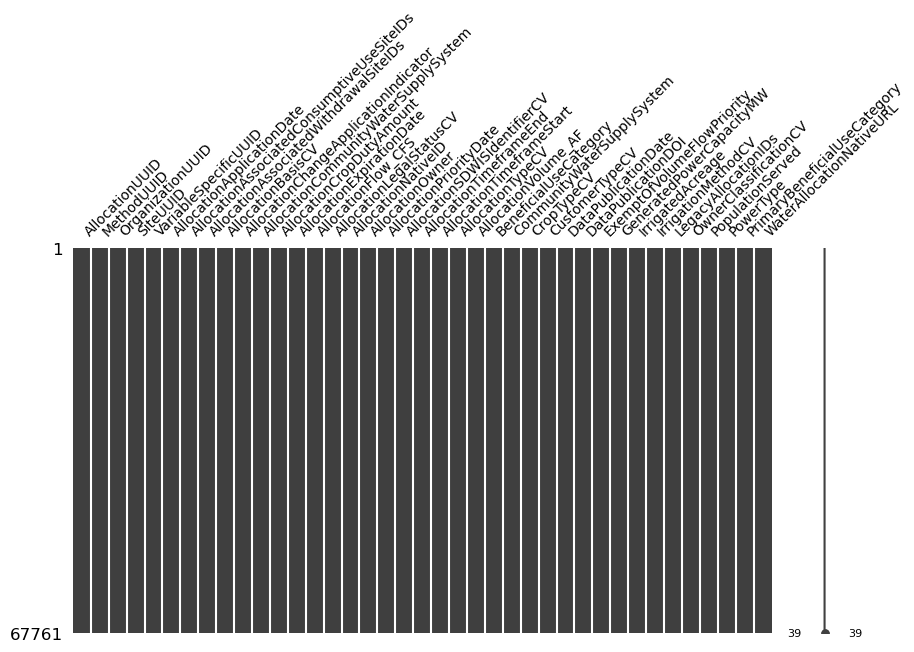

In [27]:
# Check what columns contain missing information.
msno.matrix(dfaa, figsize=(10,5), fontsize=10)

In [28]:
# AllocationFlow_CFS: Boxplot distribution of WaDE values
try:
    trace1 = go.Violin(x=dfaa['AllocationFlow_CFS'], points='outliers', name='Violin Plot')
    trace2 = go.Histogram(x=dfaa['AllocationFlow_CFS'], name='Historgram')

    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(trace1, row=1, col=1)
    fig.add_trace(trace2, row=2, col=1)

    fig.update_layout(showlegend=False, bargap=0.2, title="AllocationFlow_CFS Distribution in waterallocations.csv", font=dict(family="Arial Bold", size=12,color="Black"))
    fig.update_xaxes(title_text="AllocationFlow_CFS Value", row=1, col=1)
    fig.update_xaxes(title_text="AllocationFlow_CFS Value", row=2, col=1)
    fig.update_yaxes(title_text="Num. of Records", row=2, col=1)
    fig.show()
    fig.write_image('DataAssessment/figures/AllocationFlow_CFS.pdf', engine="kaleido")

except: print('Could not plot AllocationFlow_CFS value.')

In [29]:
# AllocationVolume_AF: Boxplot distribution of WaDE values
try:
    trace1 = go.Violin(x=dfaa['AllocationVolume_AF'], points='outliers', name='Violin Plot')
    trace2 = go.Histogram(x=dfaa['AllocationVolume_AF'], name='Historgram')

    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(trace1, row=1, col=1)
    fig.add_trace(trace2, row=2, col=1)

    fig.update_layout(showlegend=False, bargap=0.2, title="AllocationVolume_AF Distribution in waterallocations.csv", font=dict(family="Arial Bold", size=12,color="Black"))
    fig.update_xaxes(title_text="AllocationVolume_AF Value", row=1, col=1)
    fig.update_xaxes(title_text="AllocationVolume_AF Value", row=2, col=1)
    fig.update_yaxes(title_text="Num. of Records", row=2, col=1)
    fig.show()
    fig.write_image('DataAssessment/figures/AllocationVolume_AF.pdf', engine="kaleido")

except: print('Could not plot AllocationVolume_AF value.')

In [30]:
# AllocationLegalStatusCV: histogram distribution of WaDE values
print(dfaa.AllocationLegalStatusCV.value_counts())

fig = px.histogram(dfaa, x="AllocationLegalStatusCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of AllocationLegalStatusCV Entries in waterallocations.csv",
                  xaxis_title="AllocationLegalStatusCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/AllocationLegalStatusCV.pdf', engine="kaleido")

WaDE Blank    67761
Name: AllocationLegalStatusCV, dtype: int64


In [31]:
# OwnerClassificationCV: histogram distribution of WaDE values
print(dfaa.OwnerClassificationCV.value_counts())

fig = px.histogram(dfaa, x="OwnerClassificationCV")
fig.update_layout(bargap=0.2,
                  title="Histogram of OwnerClassificationCV Entries in waterallocations.csv",
                  xaxis_title="OwnerClassificationCV Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/OwnerClassificationCV.pdf', engine="kaleido")

WaDE Blank                           55441
Private                               5597
Bureau of Land Management (USBLM)     4103
National Park Service (USNPS)         2006
Fish and Wildlife Service (USFWS)      404
Forest Service (USFS)                   71
Military                                47
Bureau Reclamation (USBR)               45
Native American                         41
Bureau of Indian Affairs (USBIA)         5
Department of Agriculture (USDA)         1
Name: OwnerClassificationCV, dtype: int64


In [32]:
# PrimaryBeneficialUseCategory: histogram distribution of WaDE values
print(dfaa.PrimaryBeneficialUseCategory.value_counts())

fig = px.histogram(dfaa, x="PrimaryBeneficialUseCategory")
fig.update_layout(bargap=0.2,
                  title="Histogram of PrimaryBeneficialUseCategory Entries in waterallocations.csv",
                  xaxis_title="PrimaryBeneficialUseCategory Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/PrimaryBeneficialUseCategory.pdf', engine="kaleido")

Agriculture Irrigation    42101
Domestic                   8189
Livestock                  5693
In-stream Flow             3608
Reservoir Storage          1977
Commercial/Industrial      1527
Public Supply              1453
Aquaculture                1169
Recreation                  577
Mining                      442
Fire                        338
Municipal Irrigation        242
Thermoelectric Cooling      148
Hydroelectric               140
Other                       133
Geothermal                   21
Aquifer Recharge              3
Name: PrimaryBeneficialUseCategory, dtype: int64


In [33]:
# ExemptOfVolumeFlowPriority: histogram distribution of WaDE values
print(dfaa.ExemptOfVolumeFlowPriority.value_counts())

fig = px.histogram(dfaa, x="ExemptOfVolumeFlowPriority")
fig.update_layout(bargap=0.2,
                  title="Histogram of ExemptOfVolumeFlowPriority Entries in waterallocations.csv",
                  xaxis_title="ExemptOfVolumeFlowPriority Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/ExemptOfVolumeFlowPriority.pdf', engine="kaleido")

0    67761
Name: ExemptOfVolumeFlowPriority, dtype: int64


In [34]:
# AllocationPriorityDate: histogram distribution of WaDE values
print(dfaa.AllocationPriorityDate.value_counts())

dfaaCopy = dfaa.copy()
dfaaCopy = dfaaCopy[(dfaaCopy['ExemptOfVolumeFlowPriority'] < 1)]
dfaaCopy = dfaaCopy.reset_index(drop=True)
fig = px.histogram(dfaaCopy, x="AllocationPriorityDate")
fig.update_layout(bargap=0.2,
                  title="Histogram of AllocationPriorityDate Entries in waterallocations.csv",
                  xaxis_title="AllocationPriorityDate Value",
                  yaxis_title="# of entries",
                  #legend_title="Legend Title",
                    font=dict(
                        family="Arial Bold",
                        size=12,
                        color="Black")
                 )
fig.show()
fig.write_image('DataAssessment/figures/AllocationPriorityDate.pdf', engine="kaleido")

1993-01-01    1979
1961-08-08     393
1983-09-19     275
1908-12-31     265
1890-12-31     250
              ... 
1942-09-11       1
1946-01-31       1
1950-10-08       1
1943-05-03       1
1970-03-04       1
Name: AllocationPriorityDate, Length: 19623, dtype: int64


In [35]:
# merge all figure pdfs into single output pdf

'''
Notes:
'merger' is used for merging multiple files into one and merger.append(absfile) will append 
 the files one by one until all pdfs are appended in the result file.
'''

from PyPDF2 import PdfFileMerger

# If files are saved in the folder 'C:\Users' then Full_Path will be replaced with C:\Users
filePath = str(os.getcwd()) + '/DataAssessment/figures'
pdfsList = os.listdir(filePath)
print(pdfsList)


# os.listdir will create the list of all files in a directory
merger = PdfFileMerger(strict=False)

for file in pdfsList:
    if file.endswith(".pdf"):
        path_with_file = os.path.join(filePath, file)
        print(path_with_file)
        merger.append(path_with_file,  import_bookmarks=False )
merger.write("DataAssessment/Figures Merged Copy.pdf")

merger.close()

['WaterSourceTypeCV.pdf', 'SiteTypeCV.pdf', 'PODorPOUSite.pdf', 'PointMap.pdf', 'PolyMap.pdf', 'AllocationFlow_CFS.pdf', 'AllocationVolume_AF.pdf', 'AllocationLegalStatusCV.pdf', 'OwnerClassificationCV.pdf', 'PrimaryBeneficialUseCategory.pdf', 'ExemptOfVolumeFlowPriority.pdf', 'AllocationPriorityDate.pdf']
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\WaterSourceTypeCV.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\SiteTypeCV.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\PODorPOUSite.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\PointMap.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\PolyMap.pdf


C:\Users\rjame\anaconda3\lib\site-packages\PyPDF2\_utils.py:411: UserWarning:

import_bookmarks is deprecated as an argument. Use import_outline instead



G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\AllocationFlow_CFS.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\AllocationVolume_AF.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\AllocationLegalStatusCV.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\OwnerClassificationCV.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\PrimaryBeneficialUseCategory.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\ExemptOfVolumeFlowPriority.pdf
G:\Shared drives\WaDE Data\Oregon\WaterAllocation/DataAssessment/figures\AllocationPriorityDate.pdf


# Removed Records compared to Source Data
- this is working just fine
- just want to comment out temporarily

In [36]:
# Explode purge.xlsx files by WaDEUUID, concat together
#################################################################

# Explode watersources_missing.xlsx records by WaDEUUID
dfwspurgeCopy = dfwspurge.assign(WaDEUUID=dfwspurge['WaDEUUID'].str.split(',')).explode('WaDEUUID').reset_index(drop=True)
dfwspurgeCopy = dfwspurgeCopy[['WaDEUUID','ReasonRemoved','IncompleteField']]

# Explode sites_missing.xlsx records by WaDEUUID
dfspurgeCopy = dfspurge.assign(WaDEUUID=dfspurge['WaDEUUID'].str.split(',')).explode('WaDEUUID').reset_index(drop=True)
dfspurgeCopy = dfspurgeCopy[['WaDEUUID','ReasonRemoved','IncompleteField']]

# Explode waterallocations_missing.xlsx records by WaDEUUID
dfaapurgeCopy = dfaapurge.assign(WaDEUUID=dfaapurge['WaDEUUID'].str.split(',')).explode('WaDEUUID').reset_index(drop=True)
dfaapurgeCopy = dfaapurgeCopy[['WaDEUUID','ReasonRemoved','IncompleteField']]

# concat purge dataframes togehter
frames = [dfwspurgeCopy, dfspurgeCopy, dfaapurgeCopy] 
dfWaDEUUID = pd.concat(frames)
dfWaDEUUID = dfWaDEUUID.drop_duplicates().reset_index(drop=True).replace(np.nan, "")
print(len(dfWaDEUUID))
dfWaDEUUID.head(1)

301767


,WaDEUUID,ReasonRemoved,IncompleteField
0,orU8983,Unused WaterSource Record,


In [37]:
# this is custom to the provided data

# attach purge dataframe to Native Source Data
# df1: ORwr_v_pod_public_input
#################################################################

if 'ReasonRemoved' in df1:
    df1 = df1.drop(['ReasonRemoved', 'IncompleteField'], axis=1)

df1Copy = dfWaDEUUID.merge(df1, how='right', on='WaDEUUID')
df1Copy = df1Copy.groupby('WaDEUUID').agg(lambda x: ','.join([str(elem) for elem in (list(set(x))) if elem!=''])).replace(np.nan, "").reset_index()
df1Copy.to_csv('RawInputData/wr_v_pod_public.zip', compression=dict(method='zip', archive_name='wr_v_pod_public.csv'), index=False)

In [38]:
# this is custom to the provided data

# attach purge dataframe to Native Source Data
# df2: ORwr_v_pou_public_input
#################################################################

if 'ReasonRemoved' in df2:
    df2 = df2.drop(['ReasonRemoved', 'IncompleteField'], axis=1)

df2Copy = dfWaDEUUID.merge(df2, how='right', on='WaDEUUID')
df2Copy = df2Copy.groupby('WaDEUUID').agg(lambda x: ','.join([str(elem) for elem in (list(set(x))) if elem!=''])).replace(np.nan, "").reset_index()
df2Copy.to_csv('RawInputData/wr_v_pou_public.zip', compression=dict(method='zip', archive_name='wr_v_pou_public.csv'), index=False)

# Custom Queries and Analysis for this Dataset

In [39]:
# asdf